In [1]:
%%capture
%pip install -U ultralytics
%pip install roboflow
%pip install opencv-python
%pip install roboflow

In [2]:
from ultralytics import YOLO
import os
import torch
from google.colab import drive
from google.colab import files
from roboflow import Roboflow
from IPython.display import Image, display
import glob
import cv2
import matplotlib.pyplot as plt
import yaml

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
ENTRENAR = False
REANUDAR = False
ENTRENARv2 = False
REANUDARv2 = False
ENTRENARv3 = False
REANUDARv3 = True
respuesta = input("ESTA BIEN?").lower().strip()


if respuesta == 's' or respuesta == 'si':
    print("\n✅ ¡Confirmado! Continuando con el proceso...")
else:
    # Lanzamos un error para detener la ejecución de celdas posteriores
    raise KeyboardInterrupt("⛔ DETENIDO POR EL USUARIO: Revisa tus variables y vuelve a ejecutar.")

ESTA BIEN?s

✅ ¡Confirmado! Continuando con el proceso...


In [4]:
print("CUDA disponible:", torch.cuda.is_available())
print("Número de GPUs:", torch.cuda.device_count())
if torch.cuda.is_available():
    print("Nombre GPU:", torch.cuda.get_device_name(0))

CUDA disponible: True
Número de GPUs: 1
Nombre GPU: Tesla T4


In [5]:
drive.mount('/content/drive')
PROJECT_ROOT = '/content/drive/MyDrive/Uni_Ovi/Proyecto_Final'
# os.chdir(PROJECT_ROOT)

print("Directorio actual:", os.getcwd())
print("Contenido del proyecto:", os.listdir())

Mounted at /content/drive
Directorio actual: /content
Contenido del proyecto: ['.config', 'drive', 'sample_data']


# Descargar y Configurar directorios

[datset utilizado](https://universe.roboflow.com/roboflow-universe-projects/safety-vests/dataset/13)

In [ ]:
def descargar_dataset_drive():
  os.makedirs("dataset", exist_ok=True)

  rf = Roboflow(api_key="PONER API KEY")


  project = rf.workspace("roboflow-universe-projects").project("safety-vests")
  version = project.version(13)


  dataset = version.download(
      model_format="yolov11"
  )

  print("Contenido de la carpeta dataset:", os.listdir("Safety-Vests-13"))

  data_yaml_path = os.path.join(PROJECT_ROOT, "Safety-Vests-13", "data.yaml")
  if not os.path.exists(data_yaml_path):
      raise FileNotFoundError(
          f"No se encontró data.yaml en: {data_yaml_path}\n"
          "Verifica que has copiado/montado la carpeta 'Safety-Vests-13' correctamente."
      )
  else:
      print("Contenido de la carpeta dataset:", os.listdir("Safety-Vests-13"))

  MODELO_PERSONAS_PATH = os.path.join(PROJECT_ROOT, "modelos", "yolo11n.pt")
  if os.path.exists(MODELO_PERSONAS_PATH):
      print(f"Usando pesos base : {MODELO_PERSONAS_PATH}")

  else:
      print("Aviso: no se encontró 'modelos/yolo11n.pt'.")
      print("Se usará 'yolo11n.pt' y Ultralytics lo descargará automáticamente si es necesario.")
      model = YOLO("yolo11n.pt")

In [ ]:
def descargar_dataset_local():


  rf = Roboflow(api_key="Poner clave API")
  project = rf.workspace("roboflow-universe-projects").project("safety-vests")
  version = project.version(13)


  dataset = version.download(
      model_format="yolov11"
  )


In [7]:
descargar_dataset_local()

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Safety-Vests-13 in yolov11:: 100%|██████████| 29630/29630 [00:06<00:00, 4470.31it/s] 


In [8]:
data_yaml_path = "/content/Safety-Vests-13"
yaml_path = os.path.join(data_yaml_path, "data.yaml")
if not os.path.exists(data_yaml_path):
    raise FileNotFoundError(
        f"No se encontró data.yaml en: {data_yaml_path}\n"
        "Verifica que has copiado/montado la carpeta 'Safety-Vests-13' correctamente."
    )
else:
    print("Contenido de la carpeta dataset:", os.listdir("Safety-Vests-13"))

MODELO_PERSONAS_PATH = os.path.join(PROJECT_ROOT, "modelos", "yolo11n.pt")
if os.path.exists(MODELO_PERSONAS_PATH):
    print(f"Usando pesos base : {MODELO_PERSONAS_PATH}")

else:
    print("Aviso: no se encontró 'modelos/yolo11n.pt'.")
    print("Se usará 'yolo11n.pt' y Ultralytics lo descargará automáticamente si es necesario.")
    model = YOLO("yolo11n.pt")

Contenido de la carpeta dataset: ['README.roboflow.txt', 'README.dataset.txt', 'test', 'valid', 'train', 'data.yaml']
Usando pesos base : /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/modelos/yolo11n.pt


# Entrenamiento

In [ ]:
def entrenar_modelo():

    model = YOLO(MODELO_PERSONAS_PATH)

    results = model.train(

        data=yaml_path,   # Ruta al dataset
        epochs=150,
        patience=15,


        imgsz=640,
        batch=16,
        workers=8,
        device=0,
        cache=True,



        optimizer='auto',
        lr0=0.01,
        lrf=0.01,
        warmup_epochs=2,


        project=os.path.join(PROJECT_ROOT, 'entrenamientos'),   # Carpeta raíz.
        name='modelo_chalecos_v1.0',     # Nombre del subproyecto.
        exist_ok=True,
        save=True,
        save_period=10,
        plots=True,
        verbose=True,
        val=True,


        mosaic=1.0,
    )

    print("\n✅ Entrenamiento finalizado.")
    print("Directorio de resultados:", results.save_dir)
    print("El mejor modelo está en:", os.path.join(results.save_dir, "weights", "best.pt"))

    return results.save_dir

In [ ]:
if ENTRENAR:
  save_dir=entrenar_modelo()

Ultralytics 8.3.234 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Safety-Vests-13/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/Uni_Ovi/Proyecto_Final/modelos/yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=modelo_chalecos_v1.0, nbs=64, nms=False, opset=None, optimize=False, optimizer=aut

In [ ]:
if REANUDAR:
  train_dir_drive = "/content/drive/MyDrive/Uni_Ovi/Proyecto_Final/entrenamientos/modelo_chalecos_v1.0"
  last_weight_path = os.path.join(train_dir_drive, "weights", "last.pt")

  print(f"Reanudando desde: {last_weight_path}")

  # 3. REANUDAR ENTRENAMIENTO
  model = YOLO(last_weight_path)
  results = model.train(resume=True)

  save_dir = results.save_dir
  print(f"Entrenamiento completado. Resultados en: {save_dir}")

Reanudando desde: /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/entrenamientos/modelo_chalecos_v1.0/weights/last.pt
Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Safety-Vests-13/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/Uni_Ovi/Proyecto_Final/entrenamientos/modelo_chalecos_v1.0/we

In [ ]:
print("Descargando el mejor modelo a tu PC...")

best_model_path = os.path.join(PROJECT_ROOT, 'entrenamientos', 'modelo_chalecos_v1.0', 'weights', 'best.pt')
model = YOLO(best_model_path)
files.download(best_model_path)

Descargando el mejor modelo a tu PC...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Validacion

In [ ]:
best_model_path = os.path.join(PROJECT_ROOT, 'entrenamientos', 'modelo_chalecos_v1.0', 'weights', 'best.pt')
model = YOLO(best_model_path)

--- Curvas de Entrenamiento ---


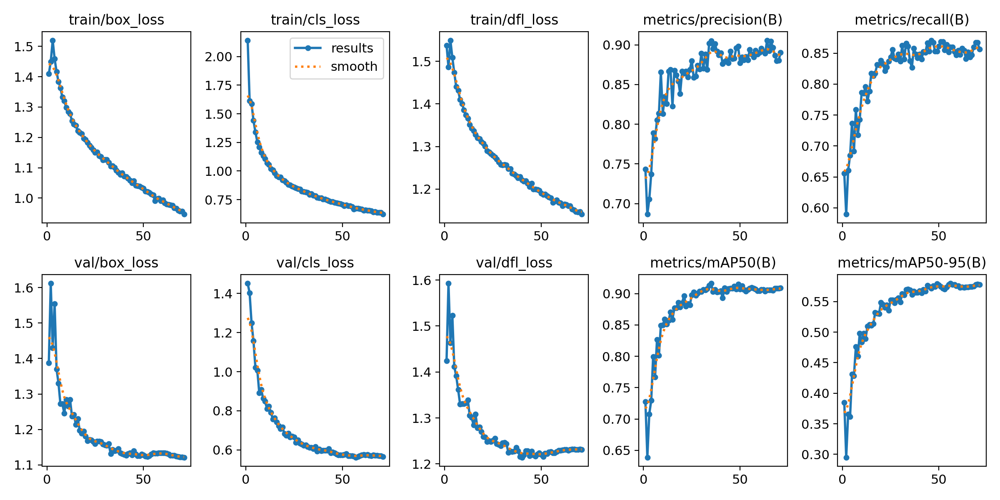

In [ ]:
print("--- Curvas de Entrenamiento ---")
display(Image(filename=os.path.join(save_dir, 'results.png')))


--- Matriz de Confusión ---


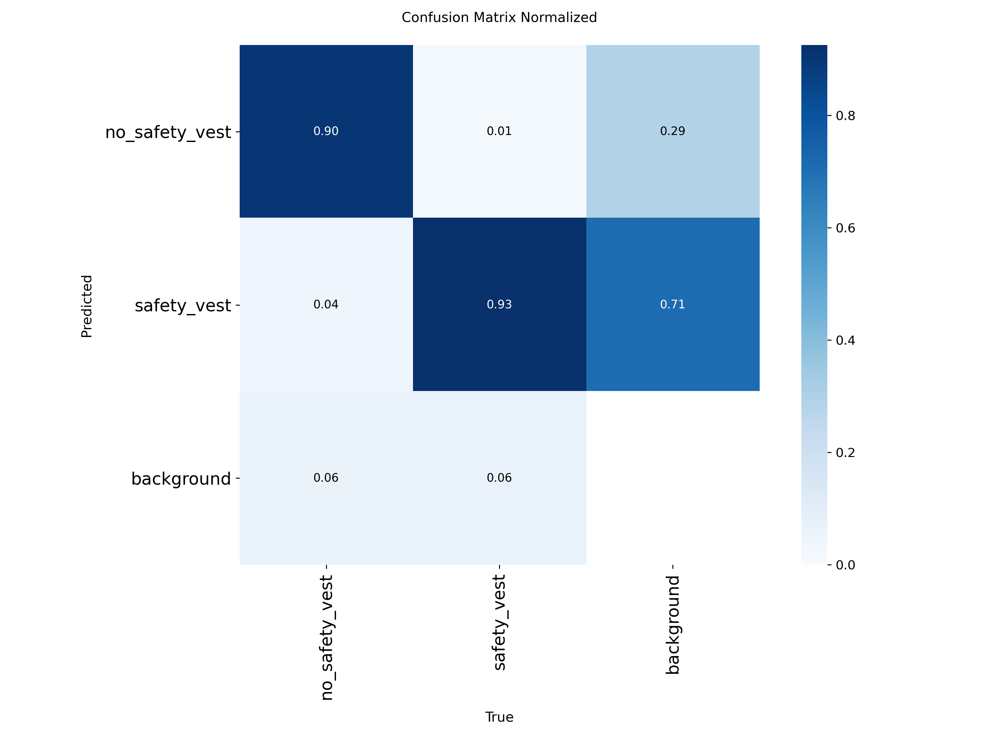


--- Curva F1-Confidence ---


In [ ]:
# Matriz de Confusión (Muestra dónde falla el modelo)
print("\n--- Matriz de Confusión ---")
# A veces YOLO lo guarda como confusion_matrix.png o confusion_matrix_normalized.png
conf_matrix_path = os.path.join(save_dir, 'confusion_matrix_normalized.png')
if os.path.exists(conf_matrix_path):
    display(Image(filename=conf_matrix_path, width=800))
else:
    print("Matriz de confusión no encontrada (quizás el modelo es perfecto o muy malo)")

# Curva F1 (Equilibrio entre precisión y recall)
print("\n--- Curva F1-Confidence ---")
f1_curve_path = os.path.join(save_dir, 'F1_curve.png')
if os.path.exists(f1_curve_path):
    display(Image(filename=f1_curve_path, width=800))

In [ ]:

metrics = model.val()

print(f"mAP50: {metrics.box.map50}")
print(f"Precision: {metrics.box.mp}")
print(f"Recall: {metrics.box.mr}")

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1630.9±396.7 MB/s, size: 64.0 KB)
val: Scanning /content/Safety-Vests-13/valid/labels.cache... 779 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 779/779 1.4Mit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 49/49 5.6it/s 8.7s
                   all        779       1648      0.888       0.86      0.909      0.578
        no_safety_vest        189        361       0.86      0.842      0.885      0.489
           safety_vest        609       1287      0.915      0.878      0.934      0.668
Speed: 1.3ms preprocess, 4.1ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to /content/runs/detect/val
mAP50: 0.9093215412457591
Precision: 0.8879042517282534
Recall: 0.8600580705843863


--- Ejemplos de Validación (Predicciones) ---


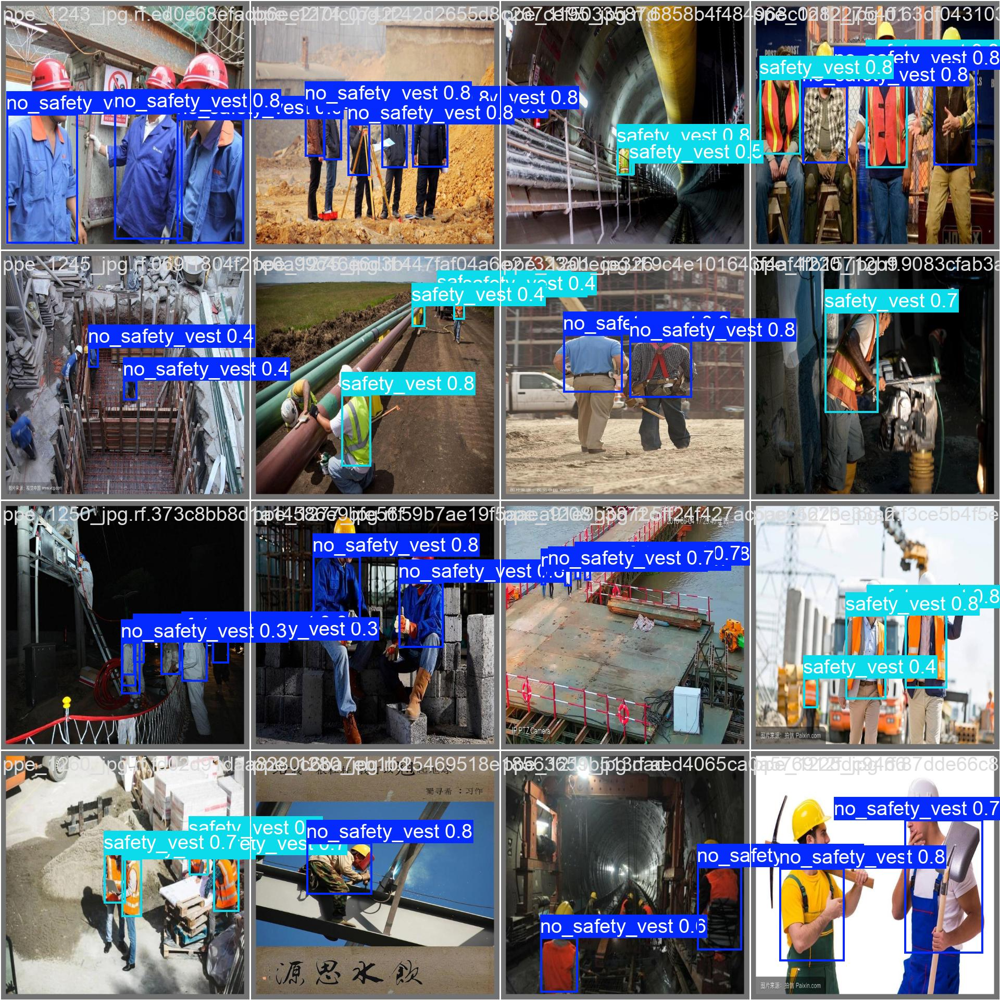

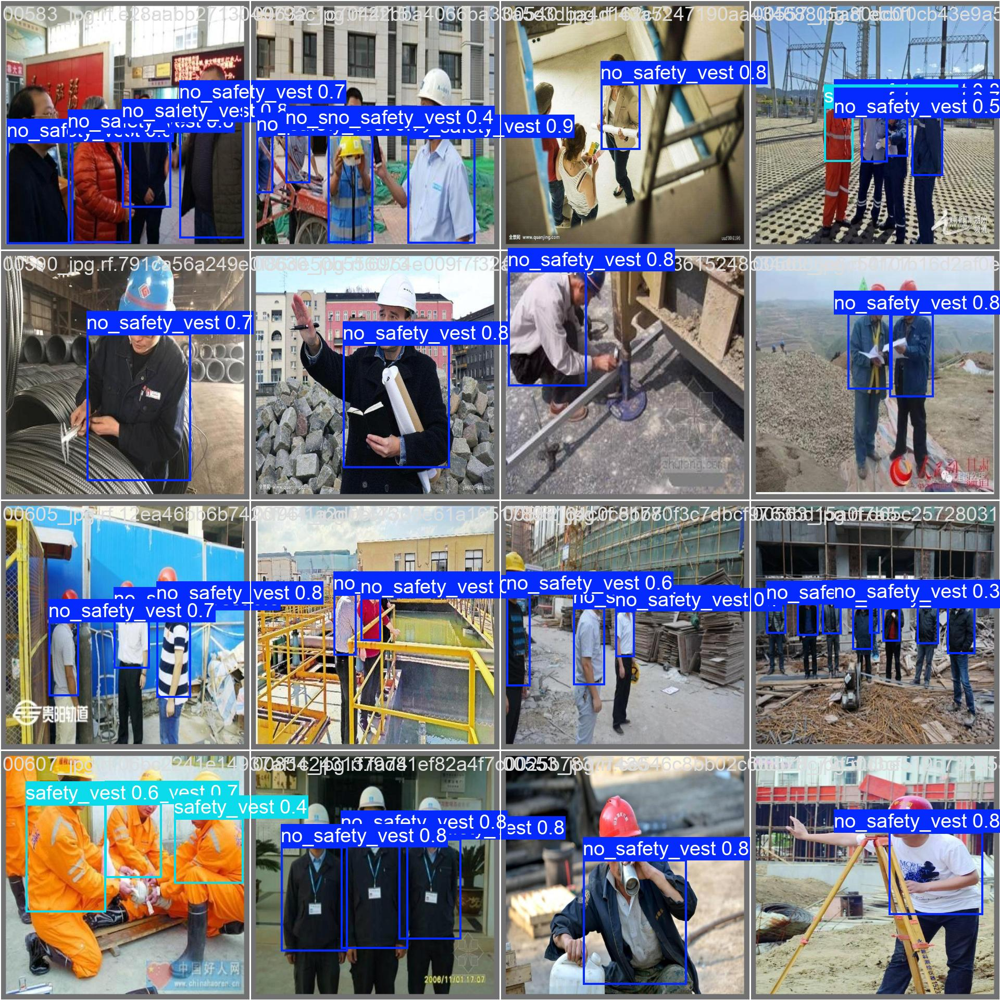

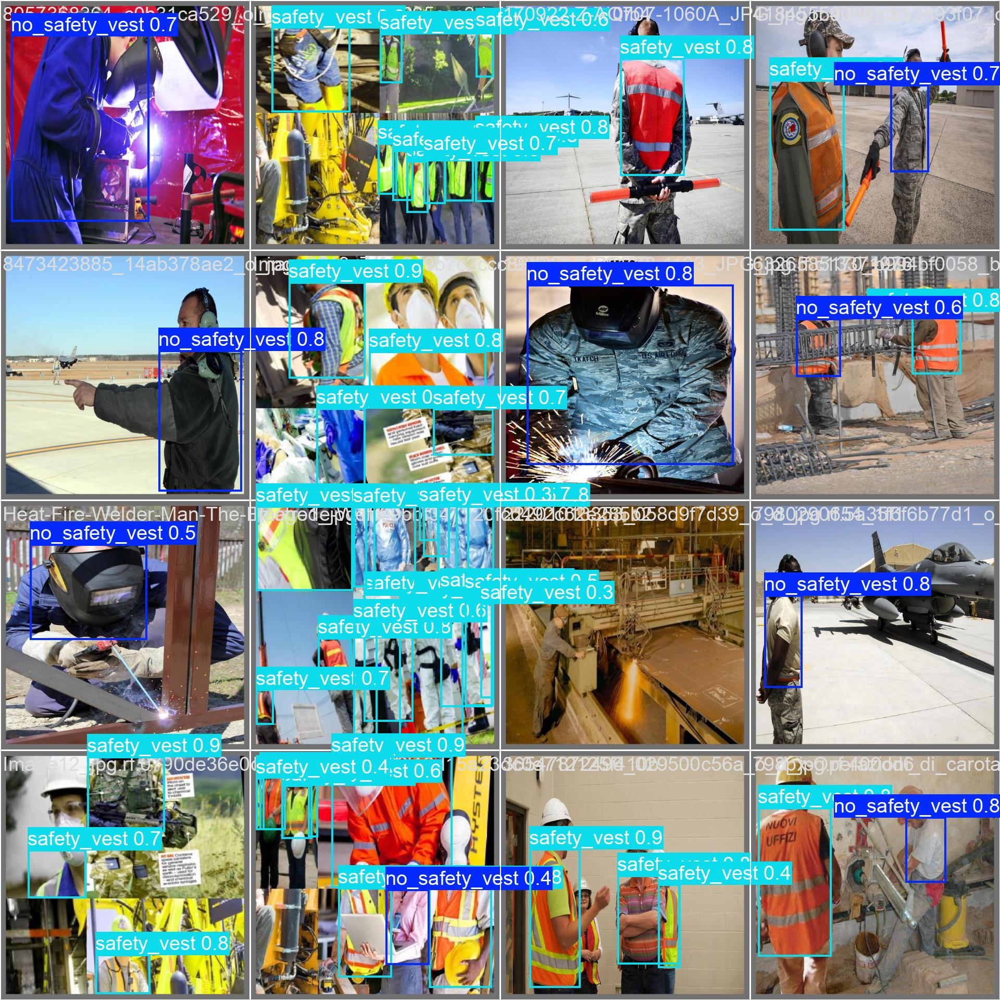

In [ ]:
print("--- Ejemplos de Validación (Predicciones) ---")
# Busca las imágenes de predicción en validación
val_preds = glob.glob(os.path.join(save_dir, 'val_batch*_pred.jpg'))

for img_path in val_preds[:3]: # Mostrar las 3 primeras
    display(Image(filename=img_path, width=600))

## Test

In [ ]:
def probar_modelo_test(modelo_path, test_images_dir):
    # Cargar el mejor modelo entrenado
    model = YOLO(modelo_path)

    # Obtener lista de imágenes de test (asegúrate de que la ruta exista en tu dataset)
    # Normalmente en: Safety-Vests-13/test/images
    test_imgs = glob.glob(os.path.join(test_images_dir, "*.jpg"))[:5] # Probamos con 5

    if not test_imgs:
        print("No se encontraron imágenes de test.")
        return

    for img_path in test_imgs:
        # Hacemos inferencia
        # conf=0.4: Solo mostrar si está 40% seguro
        # save=True: Guarda la imagen con cajas
        results = model.predict(img_path, conf=0.4, save=True, project='runs/detect', name='test_results', exist_ok=True)

        # Mostrar resultado usando Matplotlib (OpenCV imshow no va en Colab)
        img_result = results[0].plot() # Obtiene la imagen pintada con numpy

        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(img_result, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"Test: {os.path.basename(img_path)}")
        plt.show()



image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/000135_jpg.rf.668138fc448d8884b2e210f67d362a0b.jpg: 640x640 3 no_safety_vests, 1 safety_vest, 8.8ms
Speed: 1.8ms preprocess, 8.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


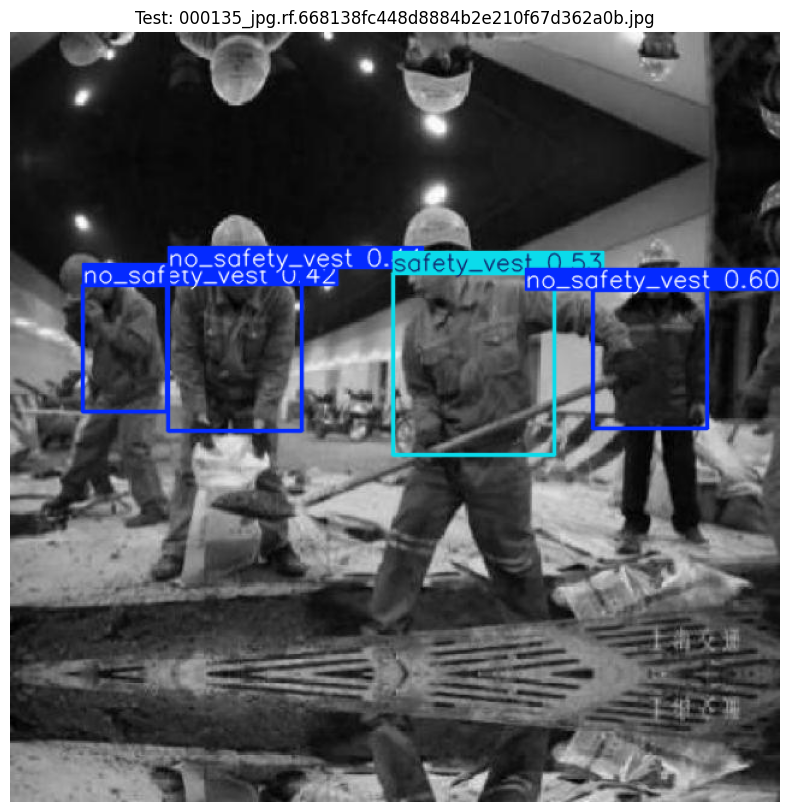


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00345_jpg.rf.cbc9f22c0e2333a9e45363743e244f21.jpg: 640x640 1 no_safety_vest, 1 safety_vest, 9.0ms
Speed: 1.7ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


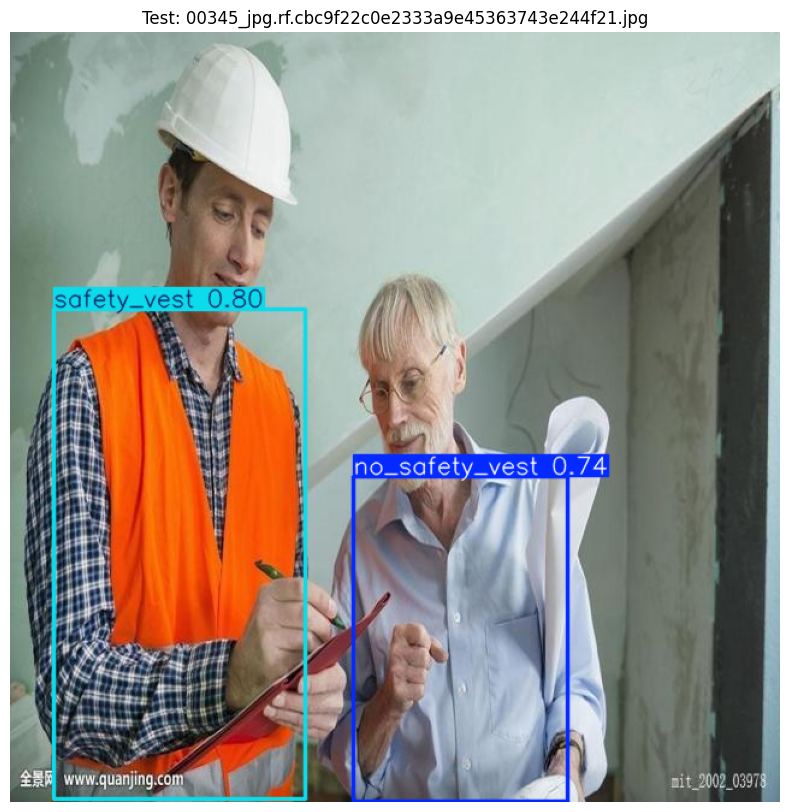


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00372_jpg.rf.83626dd62c3607304c79be979e4b6396.jpg: 640x640 1 no_safety_vest, 2 safety_vests, 8.4ms
Speed: 2.0ms preprocess, 8.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


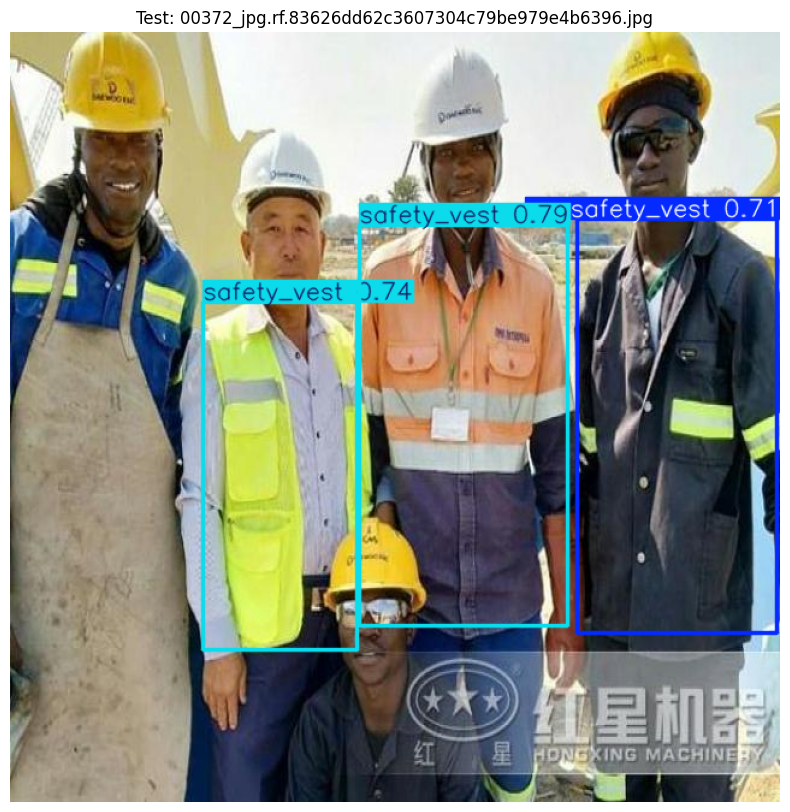


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00411_jpg.rf.8118b9e7d0dd798f99575572ed4effa3.jpg: 640x640 1 no_safety_vest, 2 safety_vests, 20.7ms
Speed: 2.3ms preprocess, 20.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


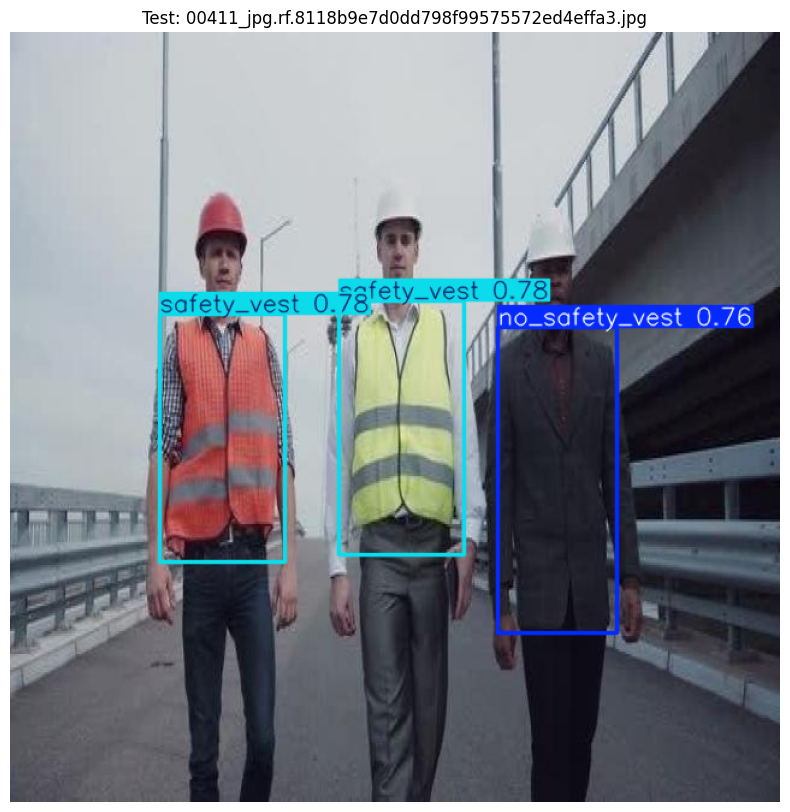


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00446_jpg.rf.01ae4d9fed9d91f9a868bf187e5b20ce.jpg: 640x640 6 safety_vests, 32.7ms
Speed: 3.8ms preprocess, 32.7ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


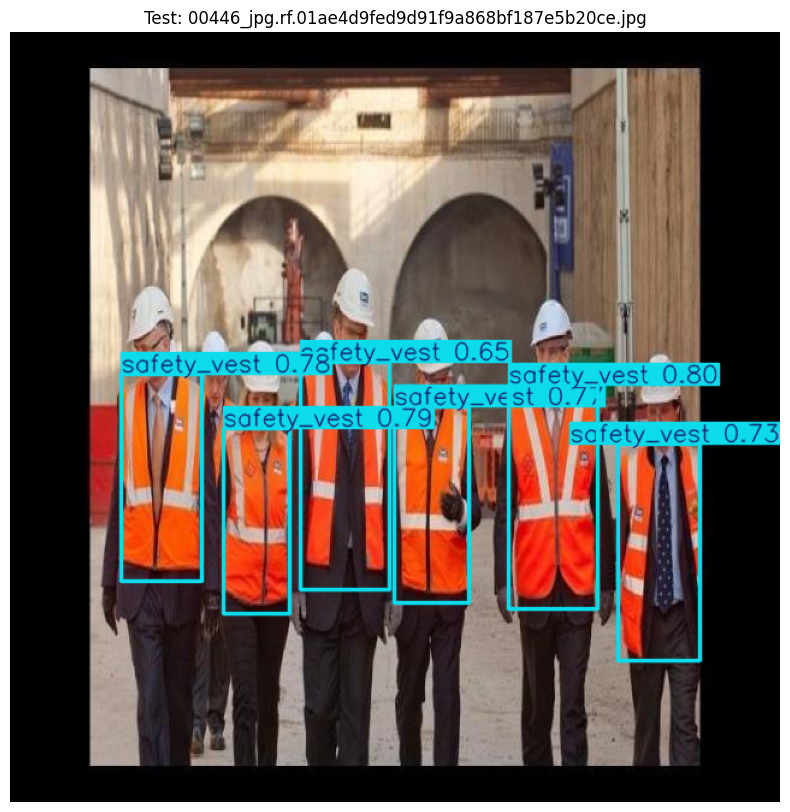

In [ ]:

best_model_path = os.path.join(PROJECT_ROOT, 'entrenamientos', 'modelo_chalecos_v1.0', 'weights', 'best.pt')
test_images_path = os.path.join(PROJECT_ROOT, "Safety-Vests-13", "test", "images")

probar_modelo_test(best_model_path, test_images_path)

# Entrenamiento V2.0

In [ ]:
def entrenar_modelo():

    model = YOLO("yolo11s.pt")

    results = model.train(

        data=yaml_path,   # Ruta al dataset
        epochs=150,
        patience=20,


        imgsz=640,
        batch=16,
        workers=8,
        device=0,
        cache=True,



        optimizer='AdamW',
        lr0=0.001,
        lrf=0.01,
        warmup_epochs=3,
        cos_lr=True,


        project=os.path.join(PROJECT_ROOT, 'entrenamientos'),   # Carpeta raíz.
        name='modelo_chalecos_v2.0',     # Nombre del subproyecto.
        exist_ok=True,
        save=True,
        save_period=10,
        plots=True,
        verbose=True,
        val=True,


        mosaic=1.0,
        close_mosaic=15,
    )

    print("\n✅ Entrenamiento finalizado.")
    print("Directorio de resultados:", results.save_dir)
    print("El mejor modelo está en:", os.path.join(results.save_dir, "weights", "best.pt"))

    return results.save_dir

In [ ]:
if ENTRENARv2 :
  save_dir=entrenar_modelo()

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=15, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/Safety-Vests-13/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=modelo_chalecos_v2.0, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=20, perspective=0.0, p

In [ ]:
if REANUDARv2:
  train_dir_drive = "/content/drive/MyDrive/Uni_Ovi/Proyecto_Final/entrenamientos/modelo_chalecos_v2.0"
  last_weight_path = os.path.join(train_dir_drive, "weights", "last.pt")

  print(f"Reanudando desde: {last_weight_path}")

  # 3. REANUDAR ENTRENAMIENTO
  model = YOLO(last_weight_path)
  results = model.train(resume=True)

  save_dir = results.save_dir
  print(f"Entrenamiento completado. Resultados en: {save_dir}")

Reanudando desde: /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/entrenamientos/modelo_chalecos_v2.0/weights/last.pt
Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=15, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/Safety-Vests-13/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/Uni_Ovi/Proyecto_Final/entrenamientos/modelo_chalecos_v2.0/we

In [ ]:
print("Descargando el mejor modelo a tu PC...")

best_model_path = os.path.join(PROJECT_ROOT, 'entrenamientos', 'modelo_chalecos_v2.0', 'weights', 'best.pt')
model = YOLO(best_model_path)
files.download(best_model_path)

Descargando el mejor modelo a tu PC...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Validacion

In [ ]:
best_model_path = os.path.join(PROJECT_ROOT, 'entrenamientos', 'modelo_chalecos_v2.0', 'weights', 'best.pt')
model = YOLO(best_model_path)

--- Curvas de Entrenamiento ---


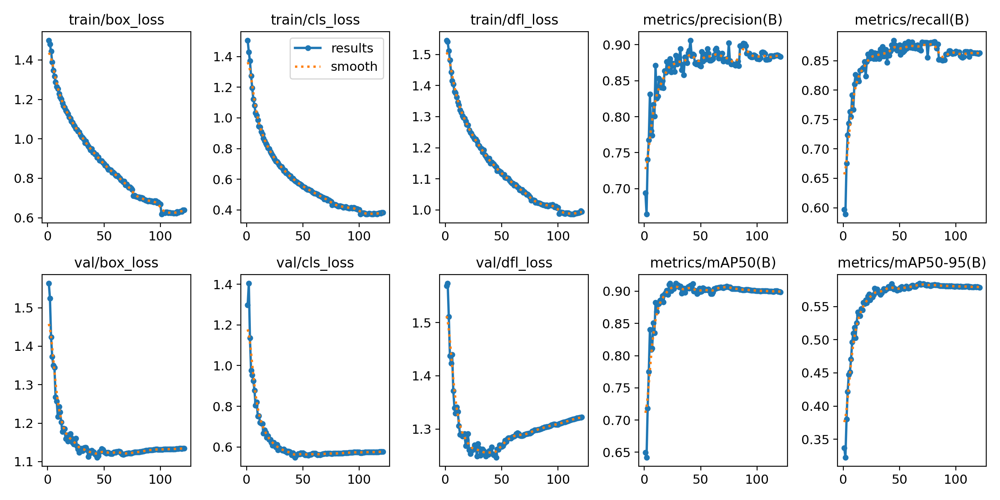


--- Matriz de Confusión ---


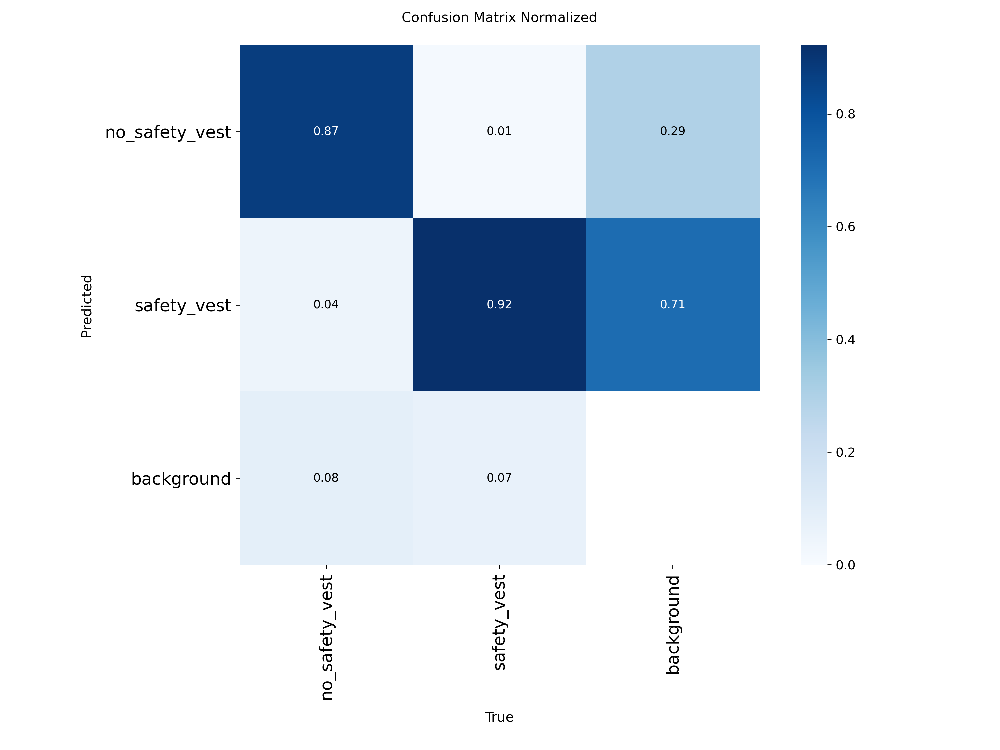


--- Curva F1-Confidence ---


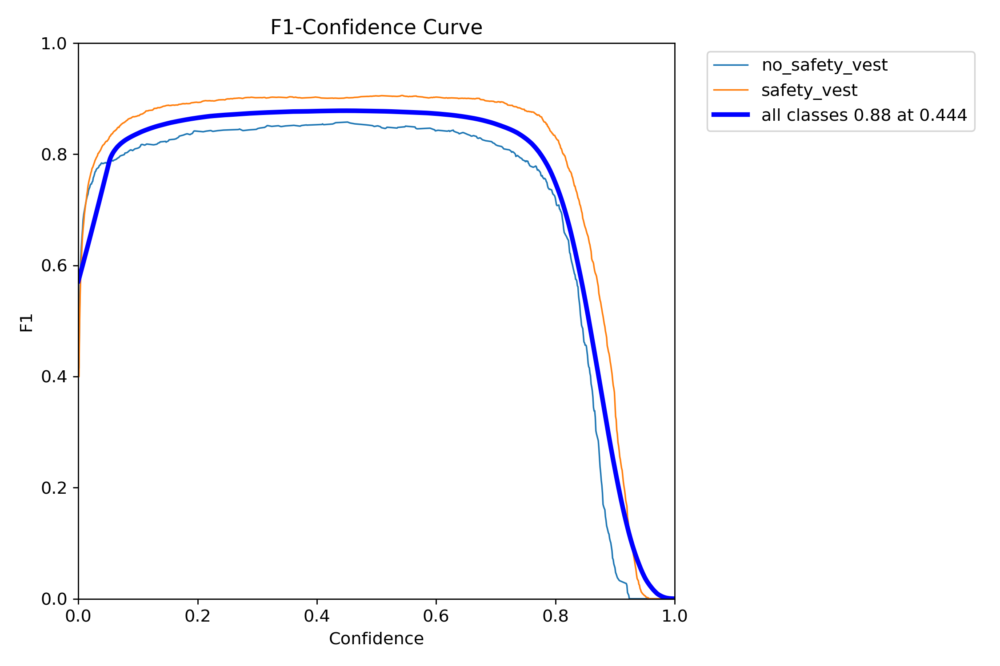

In [ ]:
print("--- Curvas de Entrenamiento ---")
display(Image(filename=os.path.join(save_dir, 'results.png')))

# Matriz de Confusión (Muestra dónde falla el modelo)
print("\n--- Matriz de Confusión ---")
# A veces YOLO lo guarda como confusion_matrix.png o confusion_matrix_normalized.png
conf_matrix_path = os.path.join(save_dir, 'confusion_matrix_normalized.png')
if os.path.exists(conf_matrix_path):
    display(Image(filename=conf_matrix_path, width=800))
else:
    print("Matriz de confusión no encontrada (quizás el modelo es perfecto o muy malo)")

# Curva F1 (Equilibrio entre precisión y recall)
print("\n--- Curva F1-Confidence ---")
f1_curve_path = os.path.join(save_dir, 'BoxF1_curve.png')
if os.path.exists(f1_curve_path):
    display(Image(filename=f1_curve_path, width=800))

In [ ]:

metrics = model.val()

print(f"mAP50: {metrics.box.map50}")
print(f"Precision: {metrics.box.mp}")
print(f"Recall: {metrics.box.mr}")

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,413,574 parameters, 0 gradients, 21.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 219.6±444.8 MB/s, size: 64.0 KB)
val: Scanning /content/Safety-Vests-13/valid/labels.cache... 779 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 779/779 1.1Mit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 49/49 3.8it/s 12.9s
                   all        779       1648      0.885      0.872      0.906      0.585
        no_safety_vest        189        361       0.86      0.853      0.872      0.486
           safety_vest        609       1287       0.91       0.89      0.941      0.683
Speed: 1.6ms preprocess, 9.6ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to /content/runs/detect/val
mAP50: 0.9064604812779345
Precision: 0.8853115728226221
Recall: 0.8715835383375916


--- Ejemplos de Validación (Predicciones) ---


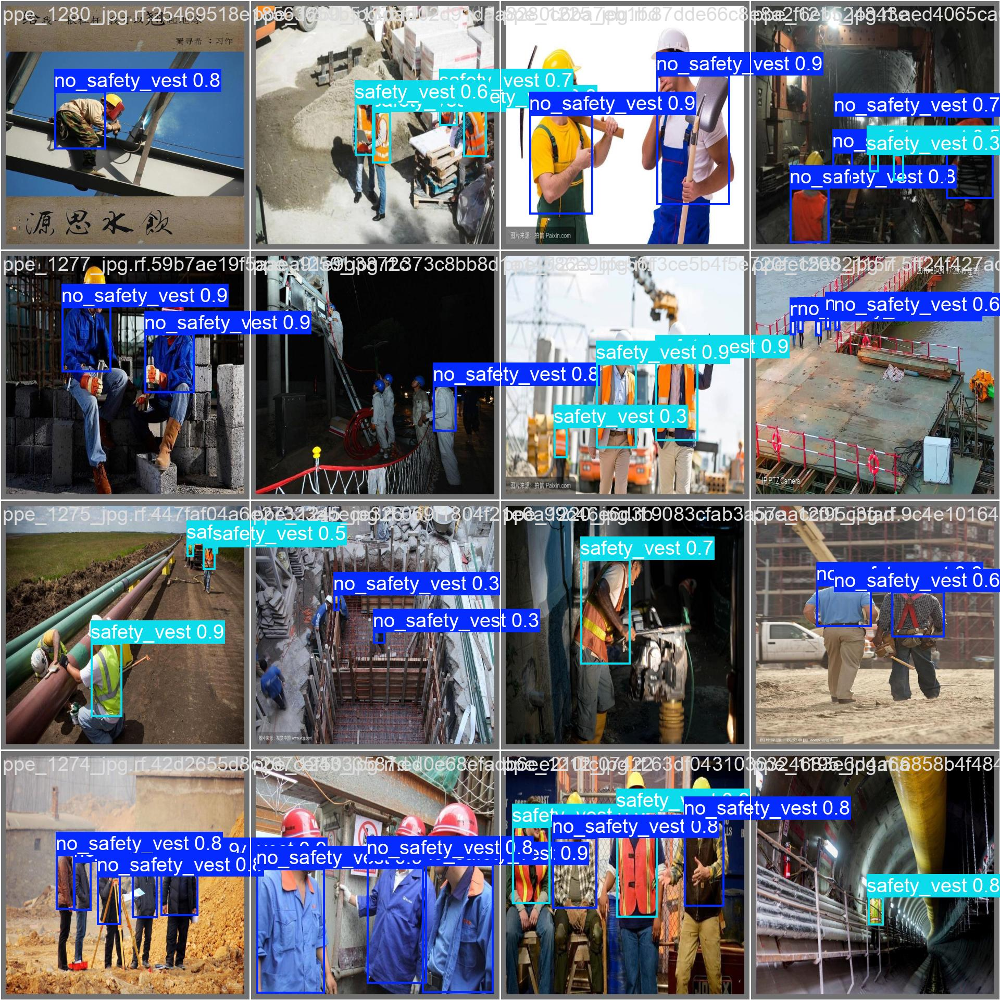

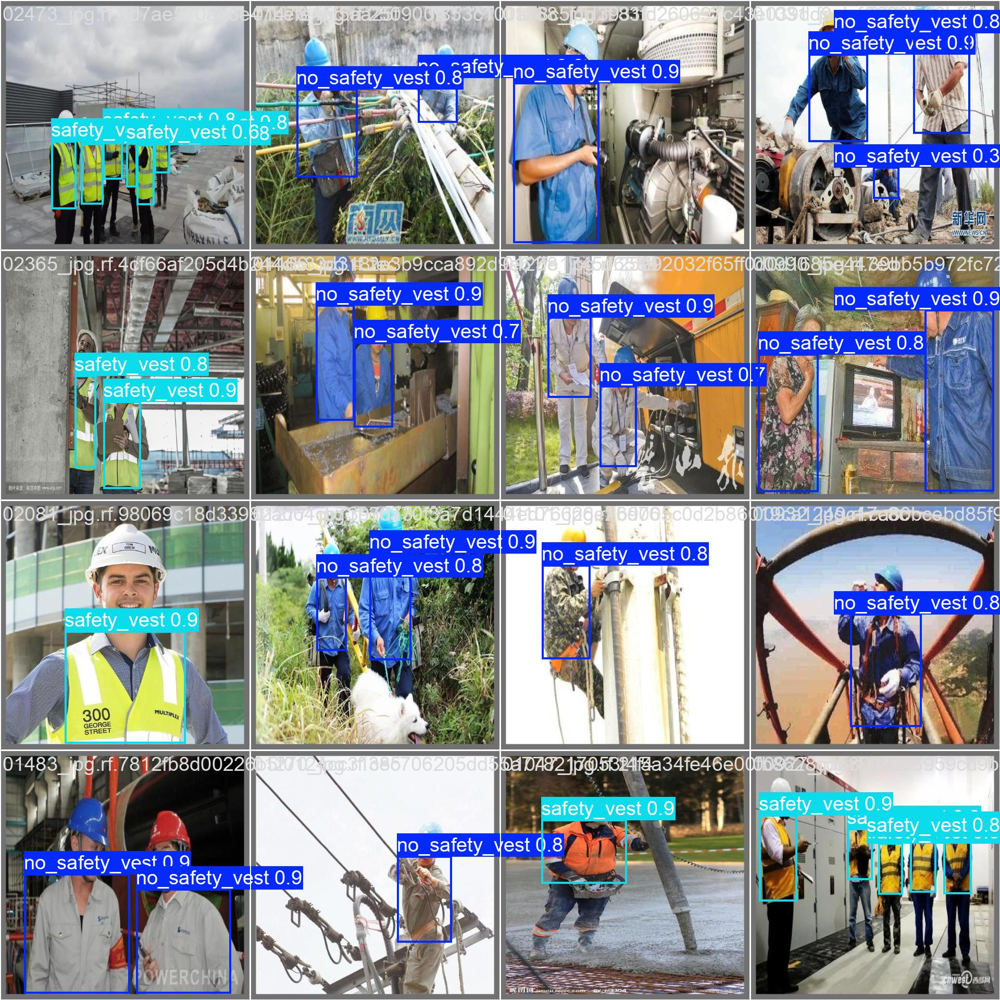

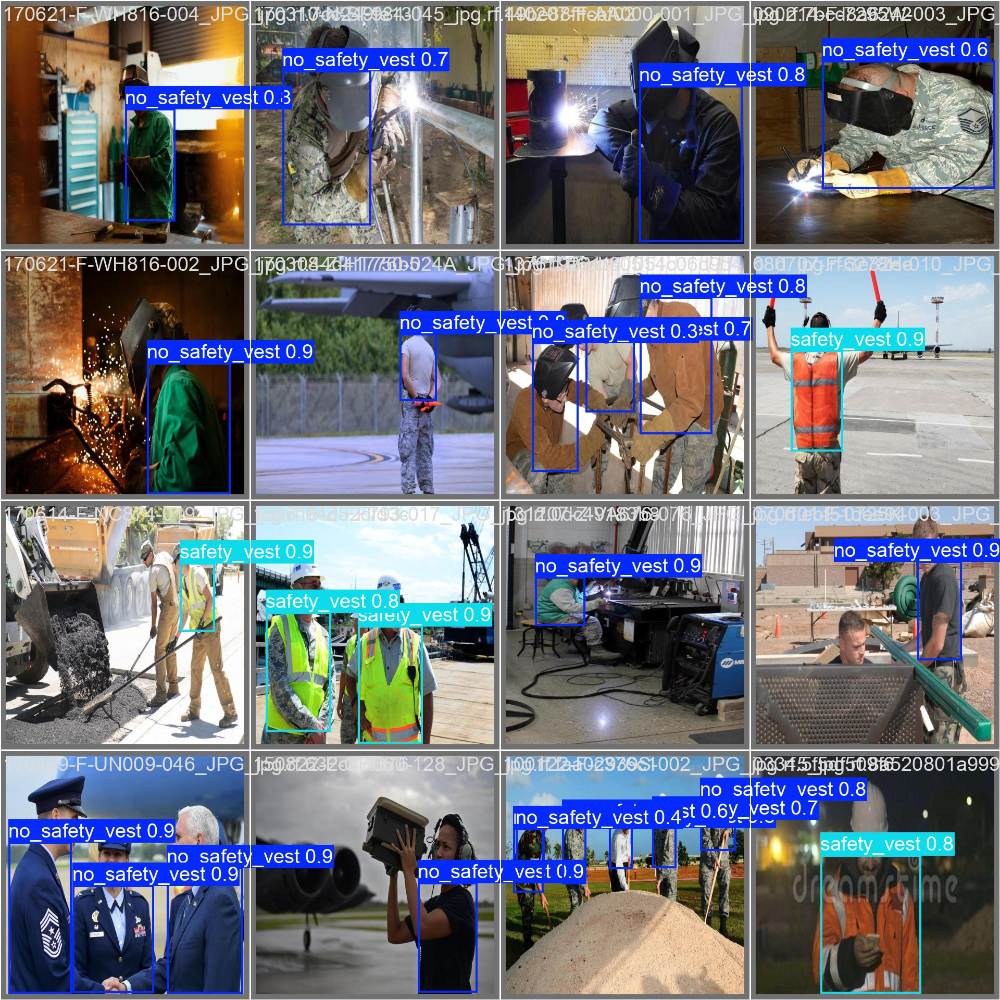

In [ ]:
print("--- Ejemplos de Validación (Predicciones) ---")
# Busca las imágenes de predicción en validación
val_preds = glob.glob(os.path.join(save_dir, 'val_batch*_pred.jpg'))

for img_path in val_preds[:3]: # Mostrar las 3 primeras
    display(Image(filename=img_path, width=600))

## Test

In [ ]:
def probar_modelo_test(modelo_path, test_images_dir):
    # Cargar el mejor modelo entrenado
    model = YOLO(modelo_path)

    # Obtener lista de imágenes de test (asegúrate de que la ruta exista en tu dataset)
    # Normalmente en: Safety-Vests-13/test/images
    test_imgs = glob.glob(os.path.join(test_images_dir, "*.jpg"))[:5] # Probamos con 5

    if not test_imgs:
        print("No se encontraron imágenes de test.")
        return

    for img_path in test_imgs:
        # Hacemos inferencia
        # conf=0.4: Solo mostrar si está 40% seguro
        # save=True: Guarda la imagen con cajas
        results = model.predict(img_path, conf=0.4, save=True, project='runs/detect', name='test_results', exist_ok=True)

        # Mostrar resultado usando Matplotlib (OpenCV imshow no va en Colab)
        img_result = results[0].plot() # Obtiene la imagen pintada con numpy

        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(img_result, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"Test: {os.path.basename(img_path)}")
        plt.show()



image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/000135_jpg.rf.668138fc448d8884b2e210f67d362a0b.jpg: 640x640 3 no_safety_vests, 1 safety_vest, 15.7ms
Speed: 2.0ms preprocess, 15.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


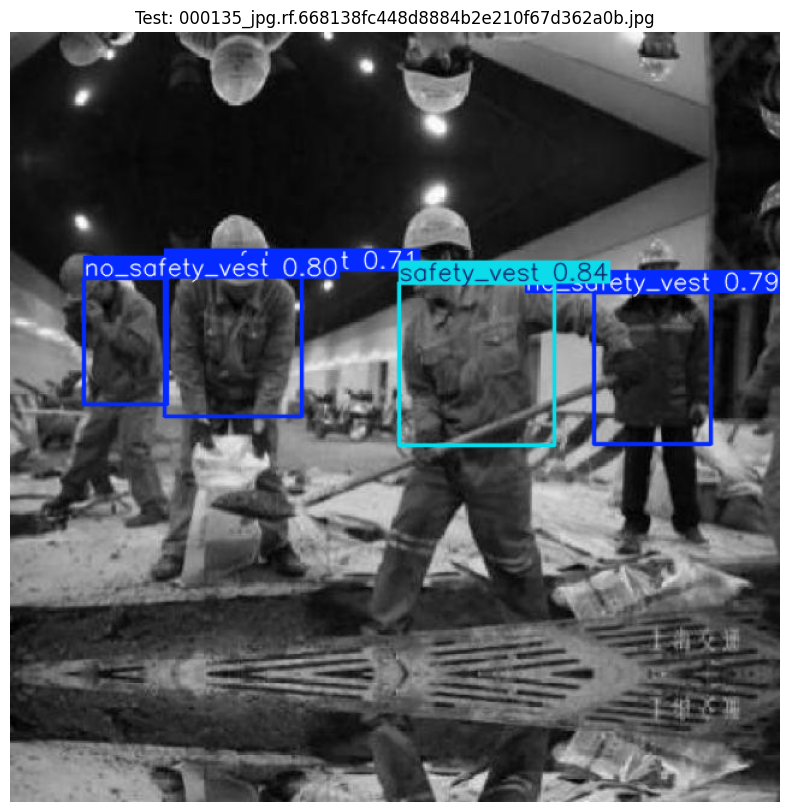


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00345_jpg.rf.cbc9f22c0e2333a9e45363743e244f21.jpg: 640x640 1 no_safety_vest, 1 safety_vest, 15.8ms
Speed: 2.3ms preprocess, 15.8ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


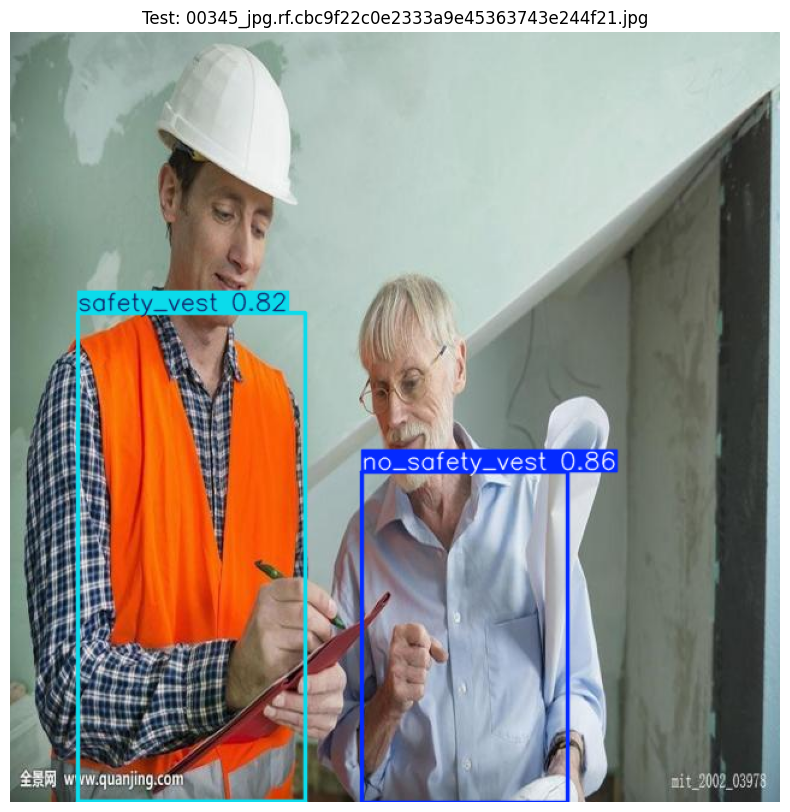


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00372_jpg.rf.83626dd62c3607304c79be979e4b6396.jpg: 640x640 1 no_safety_vest, 2 safety_vests, 15.7ms
Speed: 1.8ms preprocess, 15.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


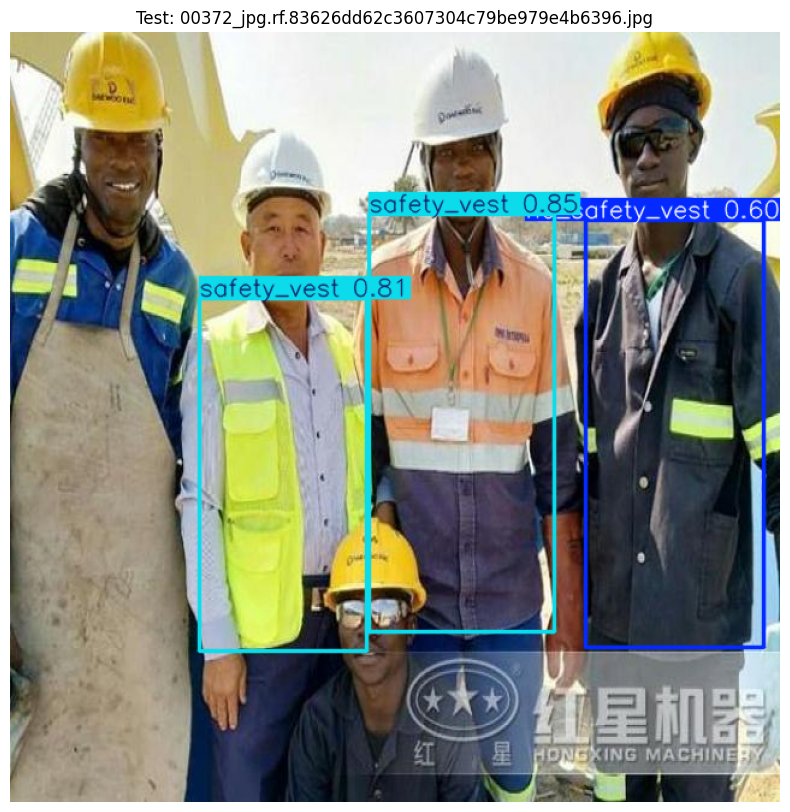


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00411_jpg.rf.8118b9e7d0dd798f99575572ed4effa3.jpg: 640x640 1 no_safety_vest, 2 safety_vests, 15.7ms
Speed: 2.3ms preprocess, 15.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


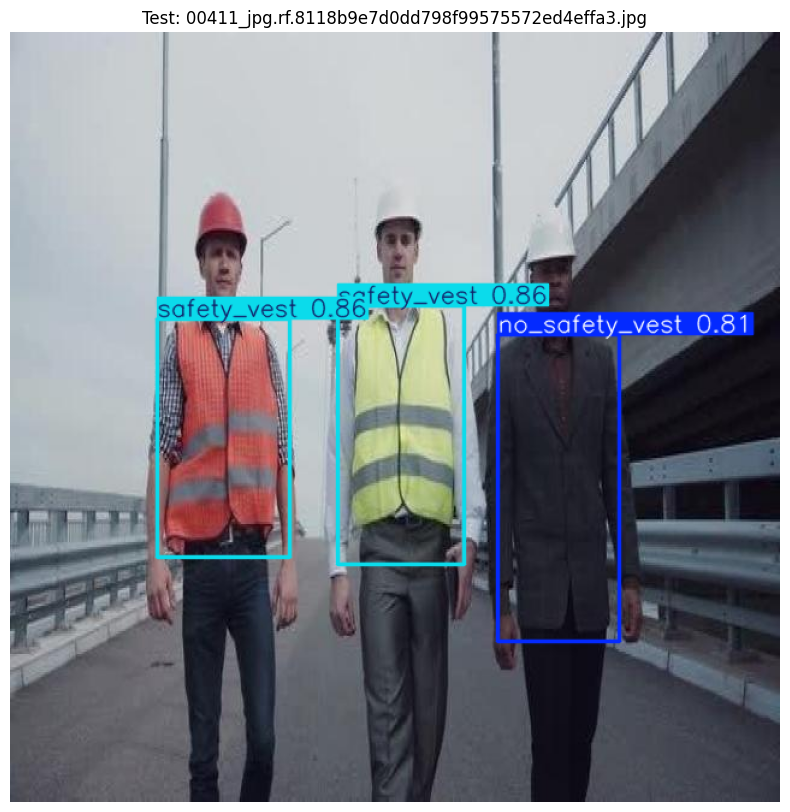


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00446_jpg.rf.01ae4d9fed9d91f9a868bf187e5b20ce.jpg: 640x640 6 safety_vests, 15.7ms
Speed: 2.2ms preprocess, 15.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


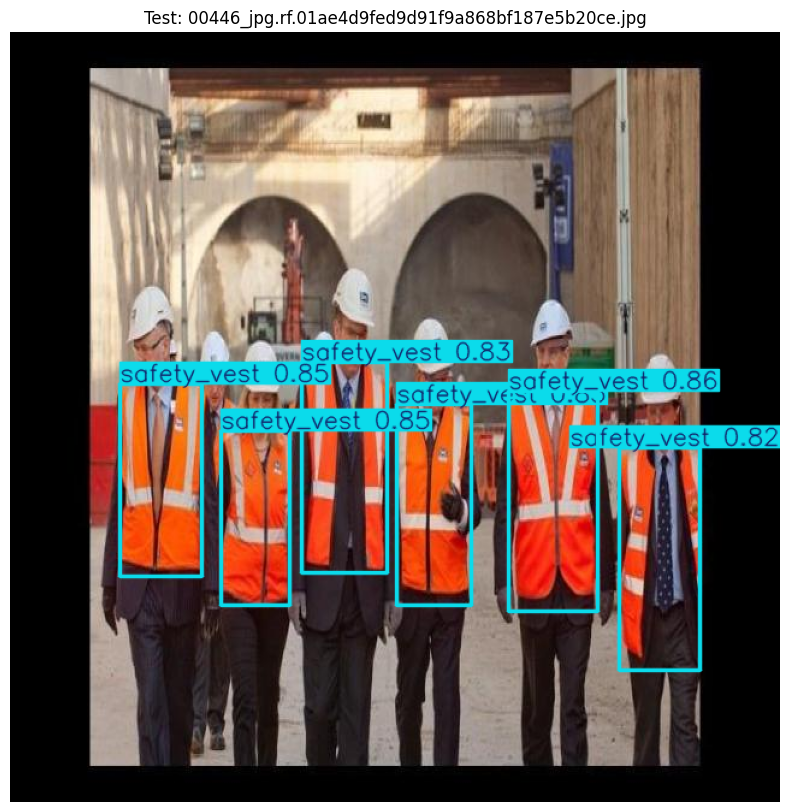

In [ ]:

best_model_path = os.path.join(PROJECT_ROOT, 'entrenamientos', 'modelo_chalecos_v2.0', 'weights', 'best.pt')
test_images_path = os.path.join(PROJECT_ROOT, "Safety-Vests-13", "test", "images")

probar_modelo_test(best_model_path, test_images_path)

# Entrenamiento v3.0


In [9]:
def entrenar_modelo_pro():
    # CAMBIO 1: Si tienes memoria GPU de sobra, YOLO11m (Medium) es mejor que el Small.

    model = YOLO("yolo11s.pt")

    results = model.train(
        # --- CONFIGURACIÓN BÁSICA ---
        data=yaml_path,
        imgsz=640,          # Si tienes GPU potente, prueba 800 (bajando batch a 8 o 12)
        batch=16,
        workers=8,
        device=0,
        cache=True,

        # --- DURACIÓN ---
        epochs=150,
        patience=25,
        warmup_epochs=3,

        # --- OPTIMIZACIÓN ---


        optimizer='auto',
        lr0=0.01,
        lrf=0.01,
        cos_lr=True,
        momentum=0.937,
        weight_decay=0.0005,

        # --- AUMENTACIÓN ESPECÍFICA (LA CLAVE) ---
        # Personas y chalecos se mueven y cambian de tamaño. Esto es vital:
        degrees=15.0,       # Rotación +/- 15º (Gente inclinada/agachada)
        translate=0.1,      # Desplazar la imagen un 10%
        scale=0.6,          # Escalar +/- 60% (Chalecos muy cerca o muy lejos)
        fliplr=0.5,         # 50% probabilidad de espejo horizontal (mirando izq/der)
        flipud=0.0,         # 0% espejo vertical (la gente no camina de cabeza)

        # --- AUMENTACIÓN DE COLOR (Robustez a la luz) ---
        hsv_h=0.015,        # Variación leve de tono (cuidado con cambiar el color del chaleco)
        hsv_s=0.7,          # Variación fuerte de saturación (colores vivos/apagados)
        hsv_v=0.4,          # Variación media de brillo (luz/sombra)

        # --- TÉCNICAS AVANZADAS ---
        mosaic=1.0,         # Siempre 1.0, es el secreto de YOLO
        close_mosaic=15,    # Desactivar al final para afinar
        mixup=0.1,          # Mezclar imágenes (ayuda con oclusiones), valor bajo (0.1)
        copy_paste=0.1,     # Útil si tienes segmentación, si no, hace poco daño tenerlo bajo

        # --- SISTEMA ---
        project=os.path.join(PROJECT_ROOT, 'entrenamientos'),
        name='modelo_chalecos_v3.0',
        exist_ok=True,
        save=True,
        save_period=10,
        plots=True,
        verbose=True,
        val=True,
    )

    print("\n✅ Entrenamiento PRO finalizado.")
    return results.save_dir

In [ ]:
if ENTRENARv3 :
  save_dir=entrenar_modelo_pro()

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=15, cls=0.5, compile=False, conf=None, copy_paste=0.1, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/Safety-Vests-13/data.yaml, degrees=15.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.1, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=modelo_chalecos_v3.0, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=25, perspective=0.0, pl

In [9]:
if REANUDARv3:
  train_dir_drive = "/content/drive/MyDrive/Uni_Ovi/Proyecto_Final/entrenamientos/modelo_chalecos_v3.0"
  args_path = os.path.join(train_dir_drive, "args.yaml")
  last_weight_path = os.path.join(train_dir_drive, "weights", "last.pt")

  print(f"Reanudando desde: {last_weight_path}")

  # 3. REANUDAR ENTRENAMIENTO
  model = YOLO(last_weight_path)
  results = model.train(resume=True)

  save_dir = results.save_dir
  print(f"Entrenamiento completado. Resultados en: {save_dir}")

Reanudando desde: /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/entrenamientos/modelo_chalecos_v3.0/weights/last.pt
Ultralytics 8.3.239 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=15, cls=0.5, compile=False, conf=None, copy_paste=0.1, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/Safety-Vests-13/data.yaml, degrees=15.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.1, mode=train, model=/content/drive/MyDrive/Uni_Ovi/Proyecto_Final/entrenamientos/modelo_chalecos_v3.0/we

## Validacion

In [10]:
best_model_path = os.path.join(PROJECT_ROOT, 'entrenamientos', 'modelo_chalecos_v3.0', 'weights', 'best.pt')
model = YOLO(best_model_path)

--- Curvas de Entrenamiento ---


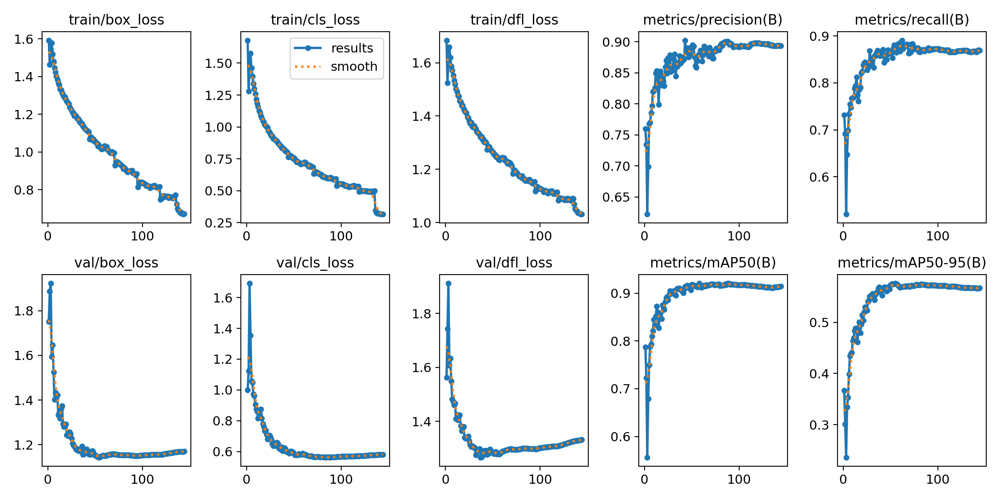


--- Matriz de Confusión ---


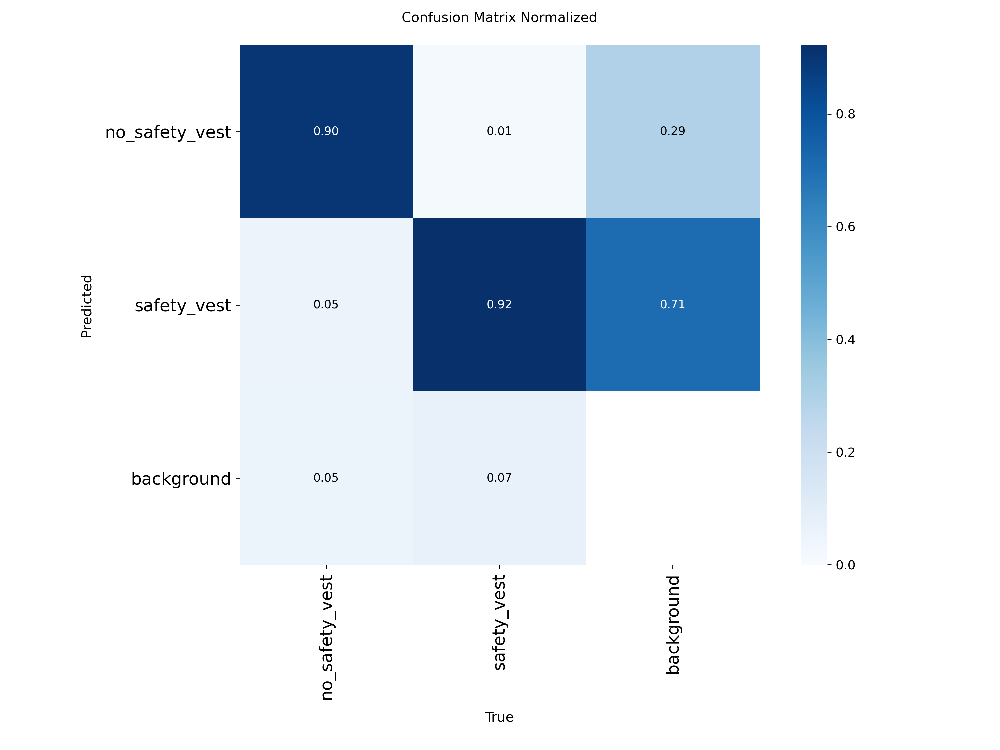


--- Curva F1-Confidence ---


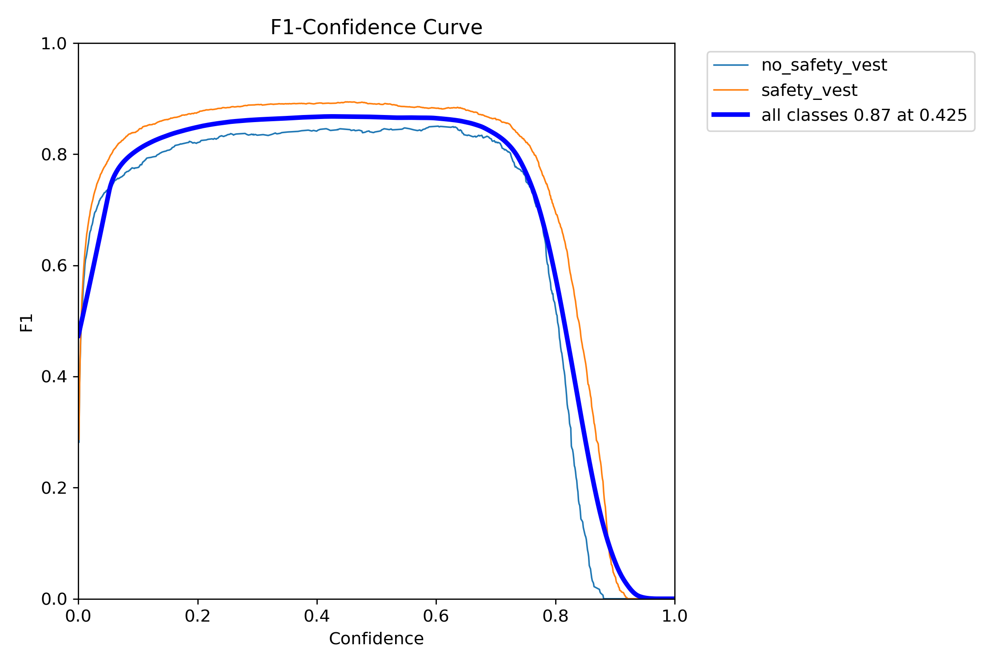

In [11]:
print("--- Curvas de Entrenamiento ---")
display(Image(filename=os.path.join(save_dir, 'results.png')))

# Matriz de Confusión (Muestra dónde falla el modelo)
print("\n--- Matriz de Confusión ---")
# A veces YOLO lo guarda como confusion_matrix.png o confusion_matrix_normalized.png
conf_matrix_path = os.path.join(save_dir, 'confusion_matrix_normalized.png')
if os.path.exists(conf_matrix_path):
    display(Image(filename=conf_matrix_path, width=800))
else:
    print("Matriz de confusión no encontrada (quizás el modelo es perfecto o muy malo)")

# Curva F1 (Equilibrio entre precisión y recall)
print("\n--- Curva F1-Confidence ---")
f1_curve_path = os.path.join(save_dir, 'BoxF1_curve.png')
if os.path.exists(f1_curve_path):
    display(Image(filename=f1_curve_path, width=800))

In [12]:

metrics = model.val()

print(f"mAP50: {metrics.box.map50}")
print(f"Precision: {metrics.box.mp}")
print(f"Recall: {metrics.box.mr}")

Ultralytics 8.3.239 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,413,574 parameters, 0 gradients, 21.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1070.6±321.4 MB/s, size: 64.0 KB)
val: Scanning /content/Safety-Vests-13/valid/labels.cache... 779 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 779/779 693.4Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 49/49 3.9it/s 12.7s
                   all        779       1648      0.859      0.876      0.914      0.577
        no_safety_vest        189        361      0.826      0.861       0.89      0.492
           safety_vest        609       1287      0.892      0.891      0.938      0.662
Speed: 1.5ms preprocess, 9.5ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to /content/runs/detect/val
mAP50: 0.9141653405698718
Precision: 0.8591502226719254
Recall: 0.8763578680476187


--- Ejemplos de Validación (Predicciones) ---


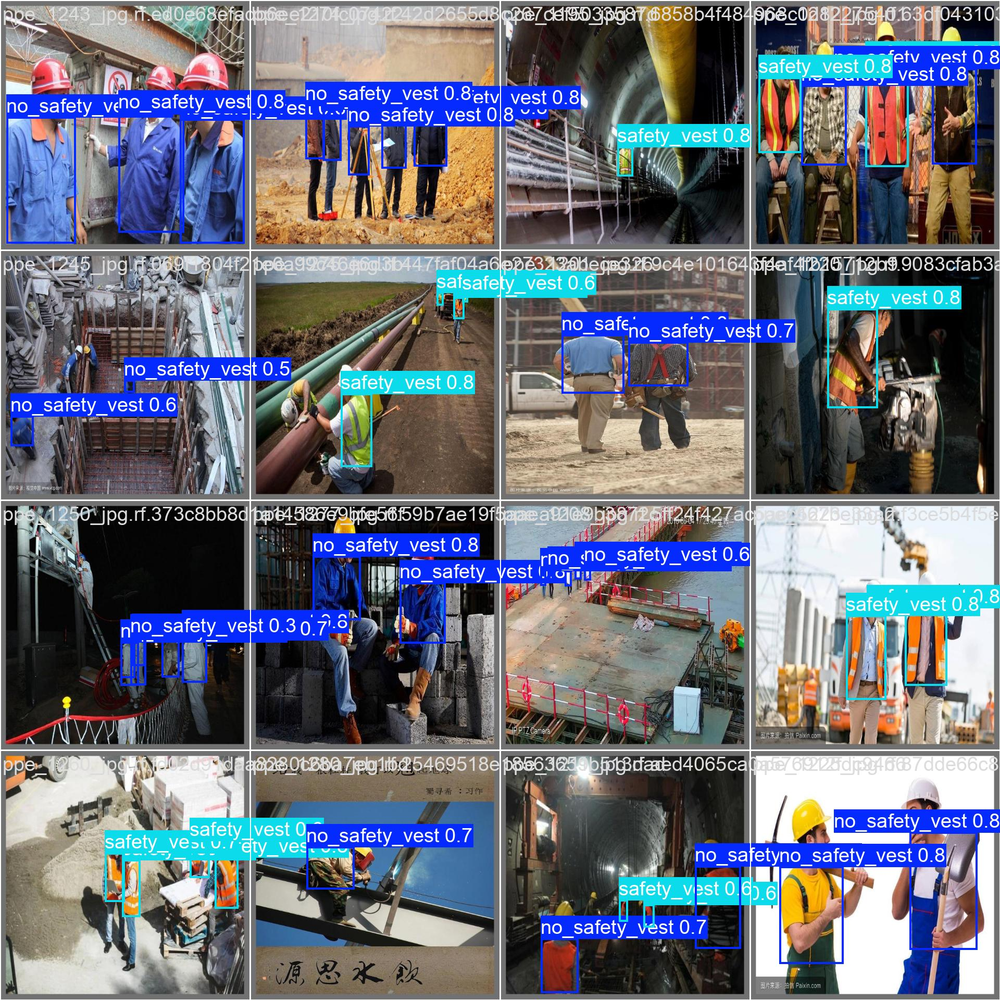

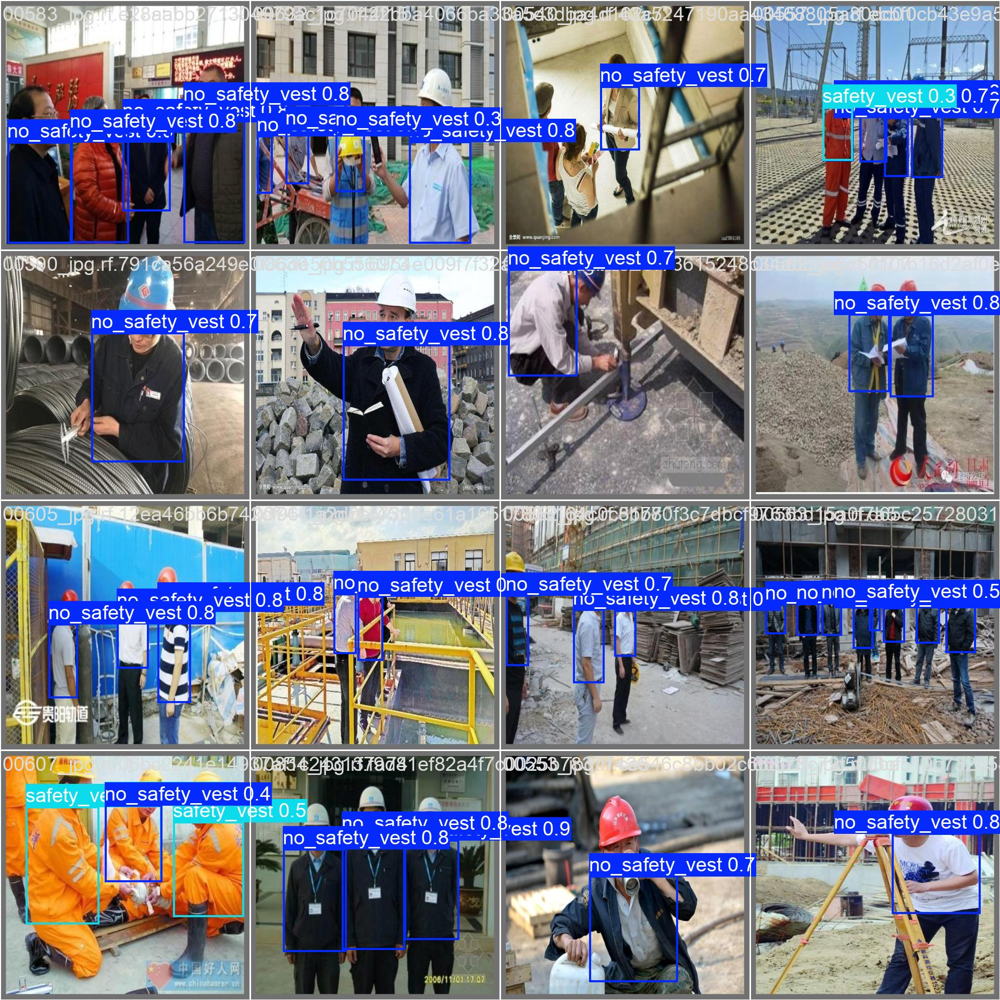

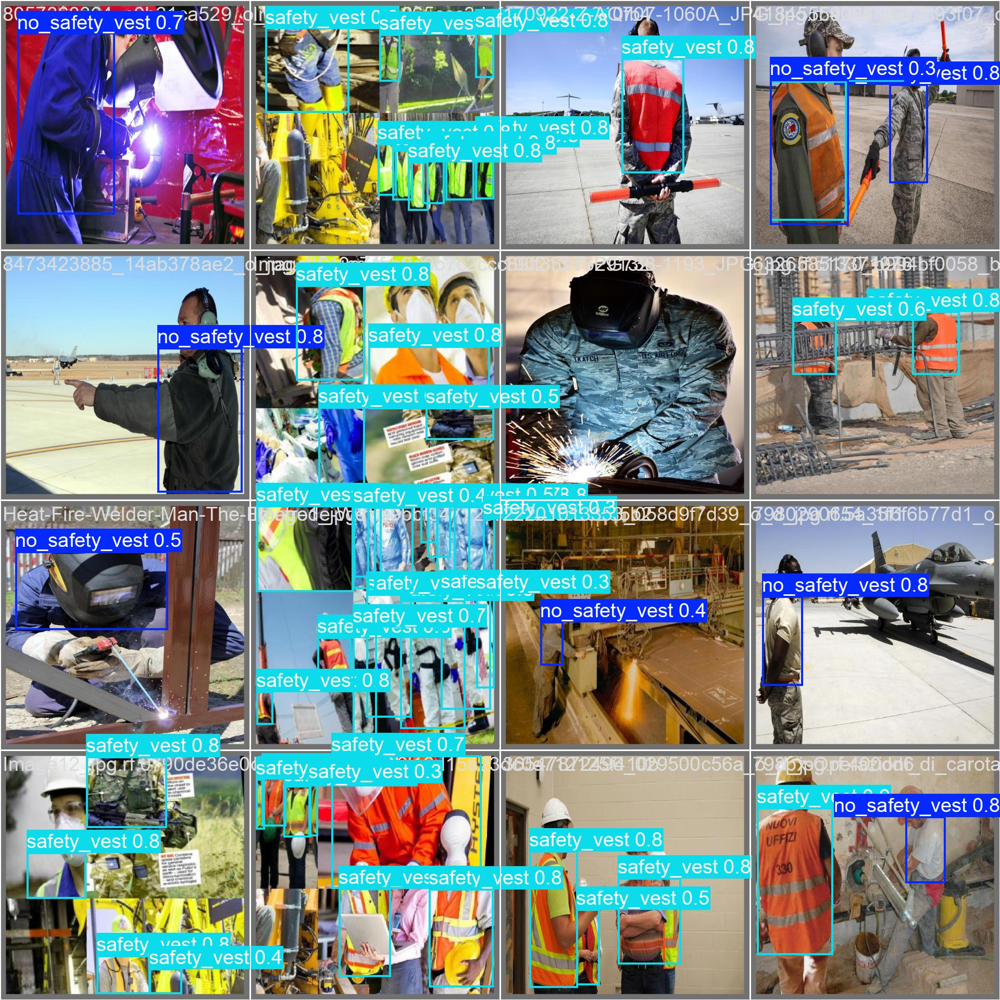

In [13]:
print("--- Ejemplos de Validación (Predicciones) ---")
# Busca las imágenes de predicción en validación
val_preds = glob.glob(os.path.join(save_dir, 'val_batch*_pred.jpg'))

for img_path in val_preds[:3]: # Mostrar las 3 primeras
    display(Image(filename=img_path, width=600))

## Test

In [14]:
def probar_modelo_test(modelo_path, test_images_dir):
    # Cargar el mejor modelo entrenado
    model = YOLO(modelo_path)

    # Obtener lista de imágenes de test (asegúrate de que la ruta exista en tu dataset)
    # Normalmente en: Safety-Vests-13/test/images
    test_imgs = glob.glob(os.path.join(test_images_dir, "*.jpg"))[:5] # Probamos con 5

    if not test_imgs:
        print("No se encontraron imágenes de test.")
        return

    for img_path in test_imgs:
        # Hacemos inferencia
        # conf=0.4: Solo mostrar si está 40% seguro
        # save=True: Guarda la imagen con cajas
        results = model.predict(img_path, conf=0.4, save=True, project='runs/detect', name='test_results', exist_ok=True)

        # Mostrar resultado usando Matplotlib (OpenCV imshow no va en Colab)
        img_result = results[0].plot() # Obtiene la imagen pintada con numpy

        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(img_result, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"Test: {os.path.basename(img_path)}")
        plt.show()



image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/000135_jpg.rf.668138fc448d8884b2e210f67d362a0b.jpg: 640x640 1 no_safety_vest, 1 safety_vest, 15.7ms
Speed: 1.8ms preprocess, 15.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


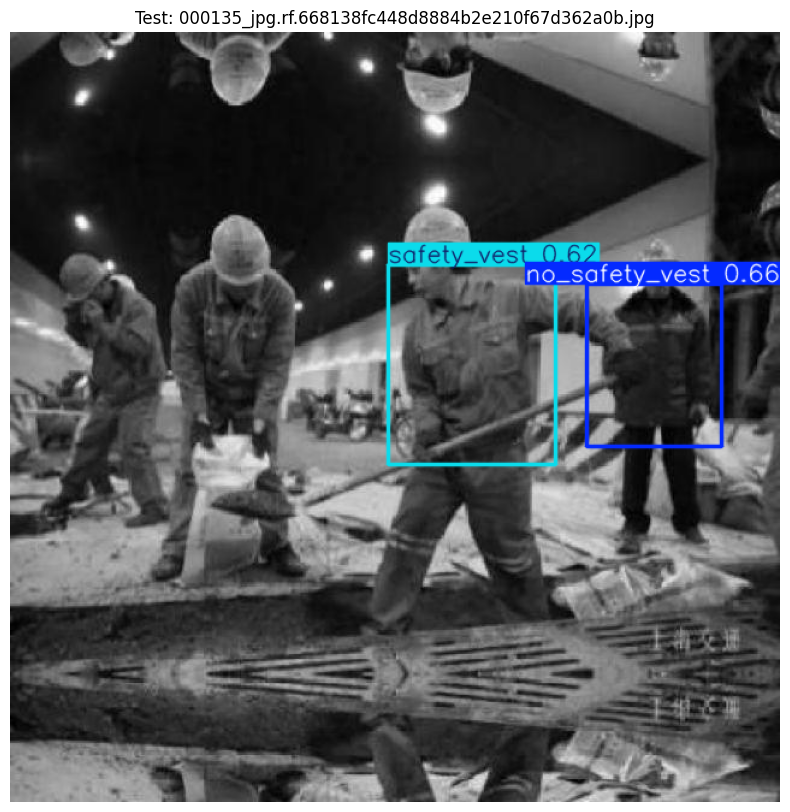


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00345_jpg.rf.cbc9f22c0e2333a9e45363743e244f21.jpg: 640x640 1 no_safety_vest, 1 safety_vest, 15.7ms
Speed: 1.7ms preprocess, 15.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


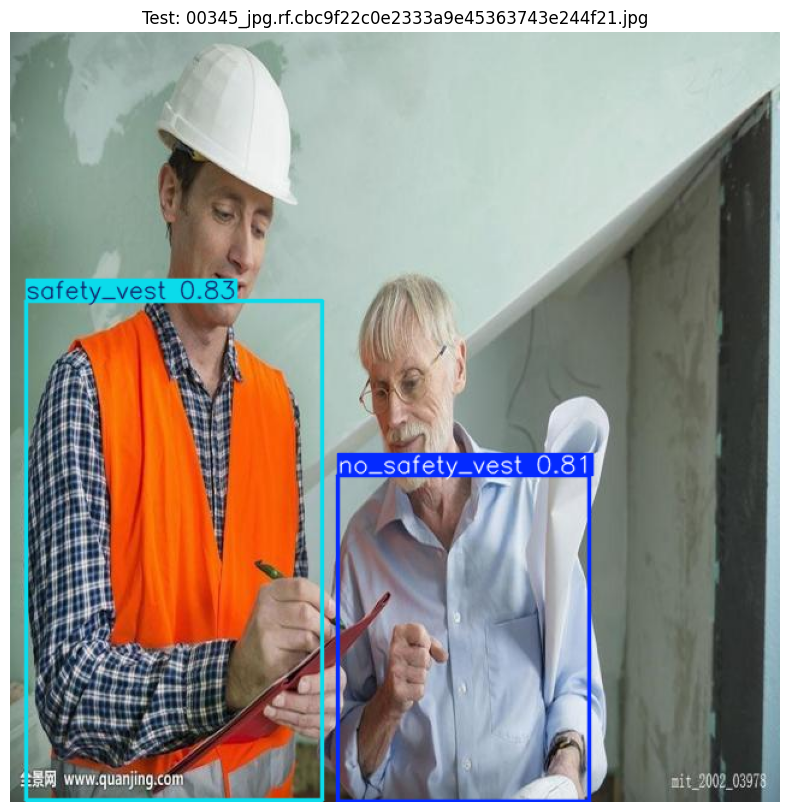


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00372_jpg.rf.83626dd62c3607304c79be979e4b6396.jpg: 640x640 1 no_safety_vest, 2 safety_vests, 15.7ms
Speed: 1.7ms preprocess, 15.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


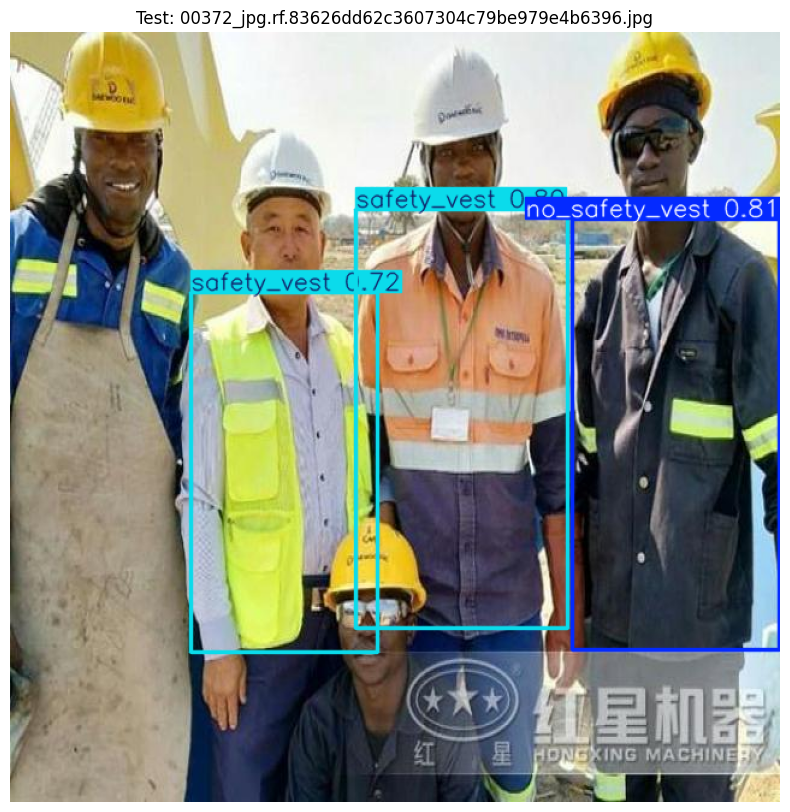


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00411_jpg.rf.8118b9e7d0dd798f99575572ed4effa3.jpg: 640x640 1 no_safety_vest, 2 safety_vests, 17.7ms
Speed: 2.5ms preprocess, 17.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


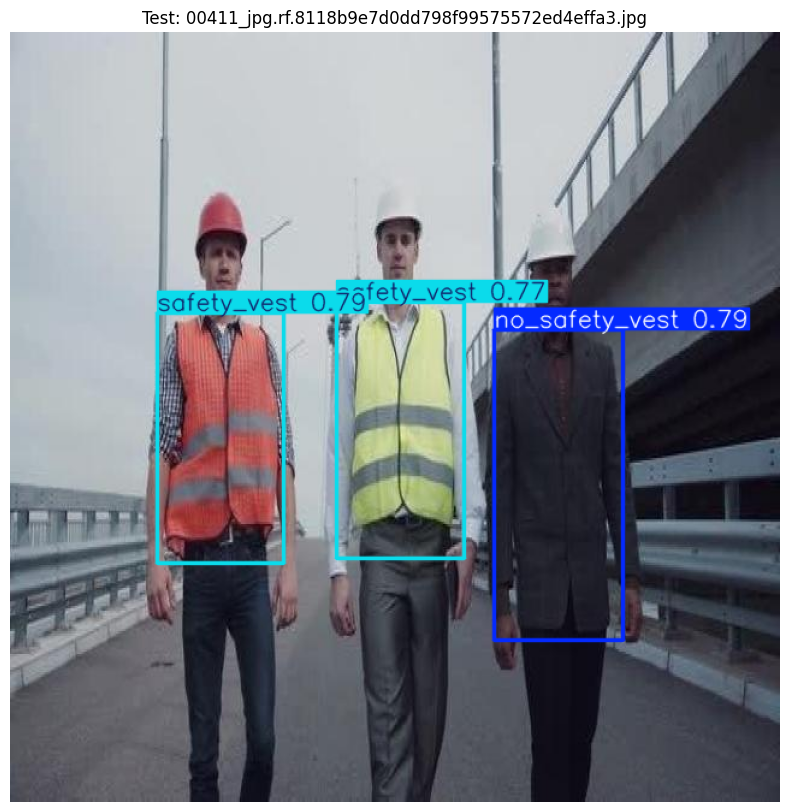


image 1/1 /content/drive/MyDrive/Uni_Ovi/Proyecto_Final/Safety-Vests-13/test/images/00446_jpg.rf.01ae4d9fed9d91f9a868bf187e5b20ce.jpg: 640x640 6 safety_vests, 15.7ms
Speed: 1.7ms preprocess, 15.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/test_results


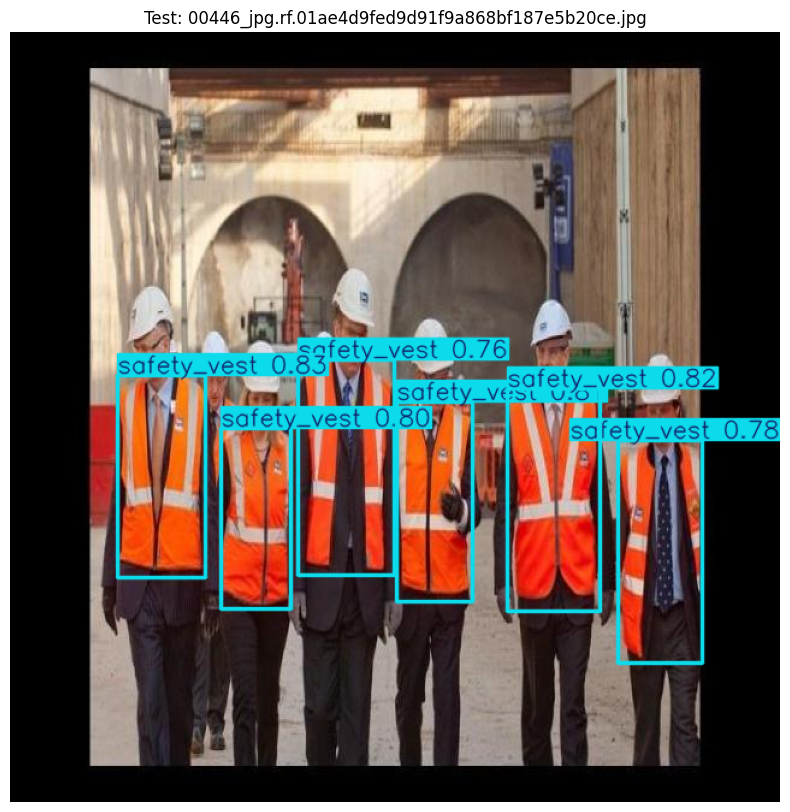

In [15]:

best_model_path = os.path.join(PROJECT_ROOT, 'entrenamientos', 'modelo_chalecos_v3.0', 'weights', 'best.pt')
test_images_path = os.path.join(PROJECT_ROOT, "Safety-Vests-13", "test", "images")

probar_modelo_test(best_model_path, test_images_path)